<a href="https://colab.research.google.com/github/bpandey369/AQI-Thesis/blob/main/Thesis_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
#from pandas_profiling import ProfileReport

color_pal = sns.color_palette()
plt.style.use('fivethirtyeight')

In [ ]:
df1  = pd.read_csv('/content/Main_AQI_v1.csv')
df2  = pd.read_csv('/content/Main_Weather_v2.csv')

In [ ]:
df1

,date,pm_cast,pm_aqi,pm_aqi_category,pm_raw,pm_qc,o3_cast,o3_aqi,o3_aqi_category,o3_raw,o3_qc
0,2017-01-01 01:00:00,NaN,NaN,NaN,NaN,Missing,NaN,NaN,NaN,NaN,Missing
1,2017-01-01 02:00:00,NaN,NaN,NaN,NaN,Missing,NaN,NaN,NaN,NaN,Missing
2,2017-01-01 03:00:00,NaN,NaN,NaN,NaN,Missing,NaN,NaN,NaN,NaN,Missing
3,2017-01-01 04:00:00,NaN,NaN,NaN,NaN,Missing,NaN,NaN,NaN,NaN,Missing
4,2017-01-01 05:00:00,NaN,NaN,NaN,NaN,Missing,NaN,NaN,NaN,NaN,Missing
...,...,...,...,...,...,...,...,...,...,...,...
57921,2023-09-10 21:00:00,19.5,67.0,Moderate,22.0,Valid,NaN,NaN,NaN,NaN,NaN
57922,2023-09-10 22:00:00,15.2,58.0,Moderate,11.0,Valid,NaN,NaN,NaN,NaN,NaN
57923,2023-09-10 23:00:00,16.1,59.0,Moderate,17.0,Valid,NaN,NaN,NaN,NaN,NaN
57924,2023-09-11 00:00:00,17.0,61.0,Moderate,18.0,Valid,NaN,NaN,NaN,NaN,NaN


In [ ]:
df2

,date,temp,visibility,dew_point,feels_like,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,wind_gust,rain_1h,clouds_all,weather_main,weather_description,weather_icon
0,2017-01-01 00:00:00,282.73,3000.0,281.97,282.73,278.72,288.63,1021,95,0.00,0,NaN,NaN,20,Mist,mist,50n
1,2017-01-01 01:00:00,282.89,2000.0,281.81,282.46,279.30,288.66,1023,93,1.54,160,NaN,NaN,75,Mist,mist,50n
2,2017-01-01 02:00:00,283.62,2500.0,282.54,283.15,279.30,289.96,1023,93,2.10,100,NaN,NaN,75,Mist,mist,50d
3,2017-01-01 03:00:00,284.35,2000.0,283.74,284.03,281.12,290.76,1023,96,0.00,0,NaN,NaN,20,Mist,mist,50d
4,2017-01-01 04:00:00,283.49,2500.0,281.42,282.85,282.21,285.55,1025,87,1.03,0,NaN,NaN,75,Mist,mist,50d
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60475,2023-09-16 19:00:00,297.09,7000.0,294.98,297.84,294.30,299.52,1016,88,2.06,90,NaN,NaN,75,Clouds,broken clouds,04n
60476,2023-09-16 20:00:00,296.63,7000.0,295.61,297.49,294.25,299.47,1015,94,2.06,50,NaN,NaN,75,Clouds,broken clouds,04n
60477,2023-09-16 21:00:00,296.63,7000.0,295.61,297.49,294.25,299.47,1015,94,1.03,0,NaN,NaN,75,Clouds,broken clouds,04n
60478,2023-09-16 22:00:00,296.63,7000.0,295.61,297.49,294.25,299.47,1014,94,1.54,110,NaN,NaN,75,Clouds,broken clouds,04n


In [ ]:
df1['date'] = pd.to_datetime(df1['date'])
df1.set_index('date',inplace=True)

In [ ]:
df2['date'] = pd.to_datetime(df2['date'])
df2.set_index('date',inplace=True)

In [ ]:
df1.sample(5)

,pm_cast,pm_aqi,pm_aqi_category,pm_raw,pm_qc,o3_cast,o3_aqi,o3_aqi_category,o3_raw,o3_qc
date,,,,,,,,,,
2020-12-28 05:00:00,78.5,163.0,Unhealthy,79.0,Valid,6.0,6.0,Good,3.0,Valid
2017-12-11 17:00:00,32.9,95.0,Moderate,35.0,Valid,27.0,25.0,Good,24.0,Valid
2018-11-16 07:00:00,86.0,167.0,Unhealthy,101.0,Valid,1.0,1.0,Good,1.0,Valid
2023-08-19 02:00:00,15.9,59.0,Moderate,15.0,Valid,NaN,NaN,NaN,NaN,NaN
2022-08-12 22:00:00,17.7,63.0,Moderate,19.0,Valid,17.0,16.0,Good,18.0,Valid


In [ ]:
df2.sample(5)

,temp,visibility,dew_point,feels_like,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,wind_gust,rain_1h,clouds_all,weather_main,weather_description,weather_icon
date,,,,,,,,,,,,,,,,
2018-07-19 13:00:00,300.06,7000.0,299.01,304.03,296.30,306.26,1007,94,0.00,0,NaN,NaN,75,Rain,light rain,10d
2022-06-27 23:00:00,297.32,6000.0,296.29,298.25,293.71,302.36,1010,94,2.06,260,NaN,0.24,75,Rain,light rain,10n
2019-10-02 07:00:00,298.21,9999.0,292.13,298.57,294.30,303.01,1018,69,4.10,270,NaN,0.15,75,Rain,light rain,10d
2021-07-09 13:00:00,300.50,8000.0,297.36,304.03,297.23,305.85,1010,83,4.12,220,NaN,1.30,75,Rain,moderate rain,10d
2021-12-25 07:00:00,289.61,6000.0,278.58,288.56,286.15,294.56,1018,48,2.06,140,NaN,0.14,20,Rain,light rain,10d


In [ ]:
df1 = df1['2017-03-01 00:00:00':'2023-09-11 01:00:00']

In [ ]:
df2 = df2['2017-03-01 00:00:00':'2023-09-11 01:00:00']

In [ ]:
df1.shape

(56511, 10)

In [ ]:
df2.shape

(58904, 16)

In [ ]:
(df2.shape[0] - df1.shape[0])/24
#99.7 days have missing row in AQI Datasets

99.70833333333333

In [ ]:
df = pd.merge(df1,df2,how='right',on='date')

In [ ]:
df

,pm_cast,pm_aqi,pm_aqi_category,pm_raw,pm_qc,o3_cast,o3_aqi,o3_aqi_category,o3_raw,o3_qc,...,pressure,humidity,wind_speed,wind_deg,wind_gust,rain_1h,clouds_all,weather_main,weather_description,weather_icon
date,,,,,,,,,,,,,,,,,,,,,
2017-03-01 00:00:00,134.9,192.0,Unhealthy,146.0,Valid,4.0,4.0,Good,4.0,Valid,...,1018,93,0.00,0,NaN,NaN,20,Mist,mist,50n
2017-03-01 01:00:00,144.5,197.0,Unhealthy,154.0,Valid,2.0,2.0,Good,2.0,Valid,...,1019,93,1.50,100,NaN,NaN,40,Mist,mist,50d
2017-03-01 02:00:00,134.0,192.0,Unhealthy,122.0,Valid,8.0,7.0,Good,8.0,Valid,...,1019,87,1.54,80,NaN,NaN,40,Mist,mist,50d
2017-03-01 03:00:00,125.9,187.0,Unhealthy,114.0,Valid,6.0,6.0,Good,6.0,Valid,...,1018,85,1.03,0,NaN,NaN,20,Mist,mist,50d
2017-03-01 04:00:00,128.0,188.0,Unhealthy,131.0,Valid,8.0,7.0,Good,8.0,Valid,...,1020,67,1.03,0,NaN,NaN,20,Mist,mist,50d
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-10 21:00:00,19.5,67.0,Moderate,22.0,Valid,NaN,NaN,NaN,NaN,NaN,...,1011,93,0.00,0,NaN,NaN,75,Clouds,broken clouds,04n
2023-09-10 22:00:00,15.2,58.0,Moderate,11.0,Valid,NaN,NaN,NaN,NaN,NaN,...,1010,95,0.00,0,NaN,NaN,75,Clouds,broken clouds,04n
2023-09-10 23:00:00,16.1,59.0,Moderate,17.0,Valid,NaN,NaN,NaN,NaN,NaN,...,1010,92,1.03,0,NaN,NaN,75,Clouds,broken clouds,04n


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 58913 entries, 2017-03-01 00:00:00 to 2023-09-11 01:00:00
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   pm_cast              57847 non-null  float64
 1   pm_aqi               57839 non-null  float64
 2   pm_aqi_category      57839 non-null  object 
 3   pm_raw               57757 non-null  float64
 4   pm_qc                58166 non-null  object 
 5   o3_cast              45421 non-null  float64
 6   o3_aqi               45367 non-null  float64
 7   o3_aqi_category      45367 non-null  object 
 8   o3_raw               49917 non-null  float64
 9   o3_qc                50470 non-null  object 
 10  temp                 58913 non-null  float64
 11  visibility           57825 non-null  float64
 12  dew_point            58909 non-null  float64
 13  feels_like           58913 non-null  float64
 14  temp_min             58913 non-null  float64
 15  t

In [ ]:
df.describe()

,pm_cast,pm_aqi,pm_raw,o3_cast,o3_aqi,o3_raw,temp,visibility,dew_point,feels_like,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,wind_gust,rain_1h,clouds_all
count,57847.000000,57839.000000,57757.000000,45421.000000,45367.000000,49917.000000,58913.000000,57825.000000,58909.000000,58913.000000,58913.000000,58913.000000,58913.000000,58913.000000,58913.000000,58913.000000,10365.000000,20652.000000,58913.000000
mean,50.098092,112.722938,50.781083,22.709165,22.785417,22.822646,293.076415,6441.257501,288.829800,293.381787,289.540658,298.619924,1014.554309,76.221072,2.105583,123.842649,0.196324,1.137285,46.664913
std,41.628901,53.685512,49.988654,17.959381,23.081771,19.988760,82.739057,1814.296878,6.449012,82.808681,82.754549,6.434435,6.722284,19.055734,41.212720,110.507798,1.346243,1.841710,26.314581
min,-1.400000,0.000000,-15.000000,-3.000000,0.000000,-21.000000,-9722.990000,50.000000,263.750000,-9729.990000,-9728.410000,-8.510000,-100.000000,0.000000,0.000000,0.000000,0.000000,0.100000,0.000000
25%,19.100000,66.000000,19.000000,8.000000,7.000000,6.000000,289.580000,6000.000000,283.340000,289.150000,286.120000,294.430000,1011.000000,64.000000,1.030000,0.000000,0.000000,0.240000,20.000000
50%,38.100000,107.000000,37.000000,19.000000,18.000000,17.000000,295.400000,7000.000000,289.480000,295.650000,291.940000,300.360000,1015.000000,82.000000,1.540000,110.000000,0.000000,0.530000,40.000000
75%,69.900000,158.000000,69.000000,33.000000,31.000000,36.000000,298.030000,7000.000000,295.000000,298.640000,294.440000,302.980000,1018.000000,93.000000,2.600000,220.000000,0.000000,1.260000,75.000000
max,662.900000,607.000000,985.000000,135.000000,232.000000,135.000000,306.530000,10000.000000,301.260000,311.070000,303.960000,312.470000,1089.000000,100.000000,9999.000000,980.000000,23.700000,34.800000,100.000000


In [ ]:
df.columns

Index(['pm_cast', 'pm_aqi', 'pm_aqi_category', 'pm_raw', 'pm_qc', 'o3_cast',
       'o3_aqi', 'o3_aqi_category', 'o3_raw', 'o3_qc', 'temp', 'visibility',
       'dew_point', 'feels_like', 'temp_min', 'temp_max', 'pressure',
       'humidity', 'wind_speed', 'wind_deg', 'wind_gust', 'rain_1h',
       'clouds_all', 'weather_main', 'weather_description', 'weather_icon'],
      dtype='object')

In [ ]:
(df['pm_aqi'] > df['o3_aqi'].fillna(0)).sum()

57211

In [ ]:
(df['pm_aqi'] < df['o3_aqi'].fillna(0)).sum()

586

In [ ]:
df['AQI'] = df[['pm_aqi','o3_aqi']].max(axis=1)

In [ ]:
df

,pm_cast,pm_aqi,pm_aqi_category,pm_raw,pm_qc,o3_cast,o3_aqi,o3_aqi_category,o3_raw,o3_qc,...,humidity,wind_speed,wind_deg,wind_gust,rain_1h,clouds_all,weather_main,weather_description,weather_icon,AQI
date,,,,,,,,,,,,,,,,,,,,,
2017-03-01 00:00:00,134.9,192.0,Unhealthy,146.0,Valid,4.0,4.0,Good,4.0,Valid,...,93,0.00,0,NaN,NaN,20,Mist,mist,50n,192.0
2017-03-01 01:00:00,144.5,197.0,Unhealthy,154.0,Valid,2.0,2.0,Good,2.0,Valid,...,93,1.50,100,NaN,NaN,40,Mist,mist,50d,197.0
2017-03-01 02:00:00,134.0,192.0,Unhealthy,122.0,Valid,8.0,7.0,Good,8.0,Valid,...,87,1.54,80,NaN,NaN,40,Mist,mist,50d,192.0
2017-03-01 03:00:00,125.9,187.0,Unhealthy,114.0,Valid,6.0,6.0,Good,6.0,Valid,...,85,1.03,0,NaN,NaN,20,Mist,mist,50d,187.0
2017-03-01 04:00:00,128.0,188.0,Unhealthy,131.0,Valid,8.0,7.0,Good,8.0,Valid,...,67,1.03,0,NaN,NaN,20,Mist,mist,50d,188.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-10 21:00:00,19.5,67.0,Moderate,22.0,Valid,NaN,NaN,NaN,NaN,NaN,...,93,0.00,0,NaN,NaN,75,Clouds,broken clouds,04n,67.0
2023-09-10 22:00:00,15.2,58.0,Moderate,11.0,Valid,NaN,NaN,NaN,NaN,NaN,...,95,0.00,0,NaN,NaN,75,Clouds,broken clouds,04n,58.0
2023-09-10 23:00:00,16.1,59.0,Moderate,17.0,Valid,NaN,NaN,NaN,NaN,NaN,...,92,1.03,0,NaN,NaN,75,Clouds,broken clouds,04n,59.0


In [ ]:
(df['AQI'] < df['pm_aqi'].fillna(0)).sum()

0

In [ ]:
(df['AQI'] < df['o3_aqi'].fillna(0)).sum()

0

In [ ]:
df = df.drop(columns =['pm_aqi','o3_aqi'])

In [ ]:
df.corr()

<ipython-input-26-2f6f6606aa2c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,pm_cast,pm_raw,o3_cast,o3_raw,temp,visibility,dew_point,feels_like,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,wind_gust,rain_1h,clouds_all,AQI
pm_cast,1.000000,0.887772,-0.004842,-0.017779,-0.024386,-0.411497,-0.660763,-0.030939,-0.023584,-0.404928,0.280355,-0.350046,0.000826,0.057092,-0.000653,-0.102733,-0.363477,0.936304
pm_raw,0.887772,1.000000,-0.034204,-0.060305,-0.019982,-0.335241,-0.559524,-0.025420,-0.019306,-0.337766,0.230425,-0.302845,0.000701,0.047722,0.016855,-0.074823,-0.307043,0.793002
o3_cast,-0.004842,-0.034204,1.000000,0.964229,0.100567,0.184531,-0.004670,0.077260,0.112642,0.098228,-0.169985,-0.159594,0.265231,0.247581,0.079811,-0.045623,-0.070576,0.063417
o3_raw,-0.017779,-0.060305,0.964229,1.000000,0.137650,0.214655,0.014542,0.114013,0.148420,0.135261,-0.187623,-0.183813,0.306414,0.281506,0.080900,-0.035865,-0.060664,0.050271
temp,-0.024386,-0.019982,0.100567,0.137650,1.000000,0.508210,0.699358,0.999915,0.999961,0.456151,0.314893,0.005398,-0.497548,0.019680,0.095773,-0.035821,0.008567,-0.026827
visibility,-0.411497,-0.335241,0.184531,0.214655,0.508210,1.000000,0.216290,0.494213,0.501759,0.478643,-0.339087,-0.322348,0.366010,0.374435,0.035788,-0.135488,0.077832,-0.423886
dew_point,-0.660763,-0.559524,-0.004670,0.014542,0.699358,0.216290,1.000000,0.750616,0.688754,0.707238,-0.600564,0.514523,-0.072107,-0.056074,0.011916,0.108574,0.555562,-0.721565
feels_like,-0.030939,-0.025420,0.077260,0.114013,0.999915,0.494213,0.750616,1.000000,0.999862,0.463074,0.309875,0.009433,-0.497132,0.020046,0.089439,-0.026231,0.013958,-0.034207
temp_min,-0.023584,-0.019306,0.112642,0.148420,0.999961,0.501759,0.688754,0.999862,1.000000,0.455203,0.314927,0.005181,-0.497548,0.019354,0.099659,-0.049854,0.008012,-0.025733
temp_max,-0.404928,-0.337766,0.098228,0.135261,0.456151,0.478643,0.707238,0.463074,0.455203,1.000000,-0.259114,-0.187682,-0.187352,0.279046,0.091246,-0.039698,0.321574,-0.455329


<Axes: xlabel='date'>

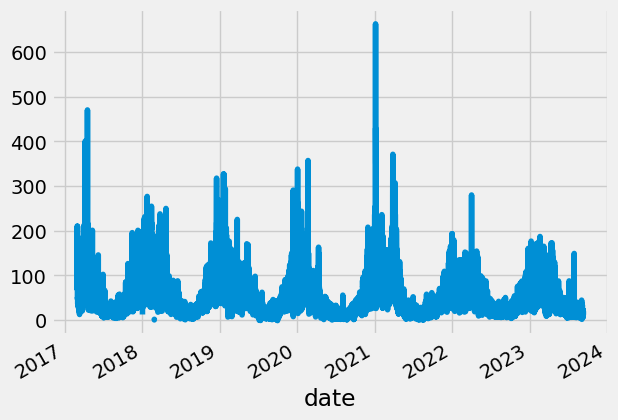

In [ ]:
df.pm_cast.plot()

In [ ]:
# Create a time series line chart with Plotly
fig = px.line(df, x=df.index, y='AQI', title='Time Series AQI Line Chart')
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Value')

# Show the chart
fig.show()

In [ ]:
df['AQI'].describe()

count    58140.000000
mean       112.463605
std         53.930666
min          0.000000
25%         66.000000
50%        107.000000
75%        158.000000
max        607.000000
Name: AQI, dtype: float64

In [ ]:
df['AQI'].isna().sum()

773

In [ ]:
pip install pandas-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 11.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 15.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 27.3 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=11ac3598b72177882712982ade2126aa452892c81593f2ffbbb6ce1c09a2c24d
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from pandas_profiling import ProfileReport

<ipython-input-32-e2a33329b6f0>:1: DeprecationWarning:

`import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.



In [ ]:
profile = ProfileReport(df)


In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df.columns

Index(['pm_cast', 'pm_aqi_category', 'pm_raw', 'pm_qc', 'o3_cast',
       'o3_aqi_category', 'o3_raw', 'o3_qc', 'temp', 'visibility', 'dew_point',
       'feels_like', 'temp_min', 'temp_max', 'pressure', 'humidity',
       'wind_speed', 'wind_deg', 'wind_gust', 'rain_1h', 'clouds_all',
       'weather_main', 'weather_description', 'weather_icon', 'AQI'],
      dtype='object')

In [ ]:
df1 = df[['pm_aqi_category', 'pm_raw', 'pm_qc',
       'o3_aqi_category', 'o3_raw', 'o3_qc', 'temp', 'visibility', 'dew_point',
       'feels_like', 'temp_min', 'temp_max', 'pressure', 'humidity',
       'wind_speed', 'wind_deg', 'wind_gust', 'rain_1h', 'clouds_all',
       'weather_main', 'weather_description', 'weather_icon', 'AQI']]

In [ ]:
profile1 = ProfileReport(df1)

In [ ]:
profile1

In [ ]:
df.to_csv('Main_AQI_v3.csv')